# 📈 Big Tech Stock Market Analysis (2010–2025)

This project performs a comprehensive analysis and predictive modeling based on historical stock data of five major technology companies: **Apple (AAPL), Amazon (AMZN), Google (GOOGL), Microsoft (MSFT)**, and **NVIDIA (NVDA)**.

---

## 📦 Dataset Overview

The dataset covers **15 years of daily historical data** (from 01/01/2010 to 01/01/2025), including:

- Opening, closing, high, and low prices for each stock  
- Daily trading volume per company  
- Relevant indicators for temporal analysis and inter-company comparison

---

## 🎯 Project Objectives

- Conduct exploratory data analysis (EDA) to understand market behavior and patterns  
- Visualize trends, volatility, and price movements over time  
- Investigate correlations between companies and volume-price relationships  
- Build predictive models to forecast future stock prices using:

  - **ARIMA / SARIMAX** – Classical time series models  
  - **Prophet (Meta)** – Forecasting with interpretable seasonal components  
  - **LSTM / Transformers** – Deep learning for sequential time series  
  - **Multivariate Regression** – Prediction based on multiple inter-company variables

---

## 🛠️ Libraries Used

- `pandas`, `numpy` – Data manipulation and analysis  
- `matplotlib`, `seaborn` – Data visualization  
- `plotly` – Interactive and advanced plotting  
- `statsmodels` – Time series modeling (ARIMA, ACF, PACF)  
- `scikit-learn` – Regression models and pipelines  
- `prophet` – Interpretable time series forecasting

---


In [66]:
# Import lib:
import warnings                          # Warning control
warnings.filterwarnings('ignore')

import pandas as pd                     # Data loading & manipulation

import matplotlib.pyplot as plt         # Basic plotting
import matplotlib.dates as mdates       # Date formatting for plots
import matplotlib.ticker as mtick       # Axis tick formatting

import seaborn as sns                   # Statistical data visualization
sns.set_theme(style='whitegrid')       # Set seaborn theme

# Statsmodels plotting functions for time series
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pandas plotting utility
from pandas.plotting import lag_plot

# Plotly for interactive plots
import plotly.express as px              # Interactive plotting (simpler interface)
import plotly.graph_objects as go        # Advanced interactive plots
from plotly.subplots import make_subplots


In [67]:
# Load dataset into a pandas DataFrame
df = pd.read_csv('/home/boto-cdr/Área de trabalho/portfolio_github/deepseek-stock-market/dados_final.csv')

# Preview the first three rows to inspect initial data structure and values
df.head(3)

,Date,Close_AAPL,Close_AMZN,Close_GOOGL,Close_MSFT,Close_NVDA,High_AAPL,High_AMZN,High_GOOGL,High_MSFT,...,Volume_AAPL,Volume_AMZN,Volume_GOOGL,Volume_MSFT,Volume_NVDA,Change_AAPL,Change_AMZN,Change_GOOGL,Change_MSFT,Change_NVDA
0,2010-01-04,7.56,6.70,15.68,30.01,0.46,7.70,6.83,15.75,30.72,...,612150000.0,152010000,39160000,73090000,800350000,"-1,56%","-0,45%","1,10%","-1,90%","-2,13%"
1,2010-01-05,7.43,6.73,15.61,28.96,0.47,7.62,6.77,15.71,30.20,...,608150000.0,177130000,60160000,102000000,728700000,"-1,72%","0,45%","-0,45%","-3,50%","2,17%"
2,2010-01-06,7.06,6.61,15.22,29.32,0.47,7.41,6.74,15.66,29.66,...,881770000.0,143620000,79610000,63380000,649170000,"-4,98%","-1,78%","-2,50%","1,24%","0,00%"


In [58]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3857 entries, 0 to 3856
Data columns (total 31 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Date          3857 non-null   object 
 1   Close_AAPL    3857 non-null   float64
 2   Close_AMZN    3857 non-null   float64
 3   Close_GOOGL   3857 non-null   float64
 4   Close_MSFT    3857 non-null   float64
 5   Close_NVDA    3857 non-null   float64
 6   High_AAPL     3857 non-null   float64
 7   High_AMZN     3857 non-null   float64
 8   High_GOOGL    3857 non-null   float64
 9   High_MSFT     3857 non-null   float64
 10  High_NVDA     3857 non-null   float64
 11  Low_AAPL      3857 non-null   float64
 12  Low_AMZN      3857 non-null   float64
 13  Low_GOOGL     3857 non-null   float64
 14  Low_MSFT      3857 non-null   float64
 15  Low_NVDA      3857 non-null   float64
 16  Open_AAPL     3857 non-null   float64
 17  Open_AMZN     3857 non-null   float64
 18  Open_GOOGL    3857 non-null 

In [68]:
# Summary Statistics
# Display the summary statistics of the dataset, including count, mean, std, min, 25%, 50%, 75%, and max values for numerical columns
df.describe()

,Close_AAPL,Close_AMZN,Close_GOOGL,Close_MSFT,Close_NVDA,High_AAPL,High_AMZN,High_GOOGL,High_MSFT,High_NVDA,...,Open_AAPL,Open_AMZN,Open_GOOGL,Open_MSFT,Open_NVDA,Volume_AAPL,Volume_AMZN,Volume_GOOGL,Volume_MSFT,Volume_NVDA
count,3857.000000,3857.000000,3857.000000,3857.000000,3857.000000,3857.000000,3857.000000,3857.000000,3857.000000,3857.000000,...,3857.000000,3857.000000,3857.000000,3857.000000,3857.000000,3.856000e+03,3.857000e+03,3.857000e+03,3.857000e+03,3.857000e+03
mean,73.601838,74.368361,63.820459,142.553306,16.289435,74.334677,75.240309,64.472865,143.869129,16.598048,...,73.538076,74.381107,63.978818,142.503928,16.293534,2.249810e+08,8.247370e+07,4.070068e+07,3.581652e+07,4.926406e+08
std,68.619686,63.669941,49.164149,129.927793,31.855051,69.299796,64.433210,49.716628,131.102767,32.484943,...,68.533630,63.691503,50.278332,129.885055,31.893915,2.166931e+08,5.149906e+07,2.277129e+07,2.071656e+07,3.051804e+08
min,6.860000,5.430000,10.910000,23.010000,0.220000,7.000000,5.560000,11.070000,23.320000,0.230000,...,6.870000,5.300000,10.970000,23.090000,0.220000,2.323000e+07,1.501000e+07,1.920000e+06,7.160000e+06,7.920000e+06
25%,20.980000,15.190000,25.290000,36.170000,0.450000,21.230000,15.310000,25.460000,36.470000,0.450000,...,21.060000,15.200000,25.190000,36.120000,0.450000,8.272000e+07,5.171000e+07,2.675000e+07,2.246000e+07,2.996000e+08
50%,38.970000,49.610000,48.530000,74.340000,3.720000,39.300000,49.950000,48.910000,74.720000,3.790000,...,38.980000,49.750000,48.640000,74.310000,3.730000,1.362150e+08,6.936000e+07,3.481000e+07,2.986000e+07,4.230900e+08
75%,135.270000,127.120000,99.790000,244.490000,14.560000,137.060000,128.990000,101.020000,246.340000,14.850000,...,135.490000,127.360000,99.430000,244.260000,14.570000,3.010625e+08,9.792000e+07,4.700000e+07,4.381000e+07,5.982600e+08
max,259.020000,242.060000,206.380000,467.560000,149.430000,260.100000,242.520000,207.050000,468.350000,153.130000,...,258.190000,239.010000,724.440000,467.000000,153.030000,1.880000e+09,8.484200e+08,2.964900e+08,3.193200e+08,3.690000e+09


In [75]:
# --- Scatter Plot: Stock Price Trends Over Time ---
# This plot visualizes the closing price trends of Apple, Amazon, Google, Microsoft, and NVIDIA between 2010 and 2025.
# It offers an interactive way to compare long-term growth patterns, including range sliders for filtering by date.

# Generate an interactive line chart showing the closing prices of all five companies
plt_data = [
    go.Scatter(x=df['Date'], y=df['Close_AAPL'], mode='lines', name='Apple (AAPL)'),
    go.Scatter(x=df['Date'], y=df['Close_AMZN'], mode='lines', name='Amazon (AMZN)'),
    go.Scatter(x=df['Date'], y=df['Close_GOOGL'], mode='lines', name='Google (GOOGL)'),
    go.Scatter(x=df['Date'], y=df['Close_MSFT'], mode='lines', name='Microsoft (MSFT)'),
    go.Scatter(x=df['Date'], y=df['Close_NVDA'], mode='lines', name='NVIDIA (NVDA)')
]

layout = go.Layout(
    title='Stock Price Trend Over Time (2010–2025)',
    xaxis=dict(
        title='Date',
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(count=6, label="6m", step="month", stepmode="backward"),
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(count=5, label="5y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=True),
        type="date"
    ),
    yaxis=dict(title='Stock Closing Price (USD)'),
    template='plotly_dark',
    height=600
)

fig = go.Figure(data=plt_data, layout=layout)
fig.show(renderer="notebook")

### 1. SD

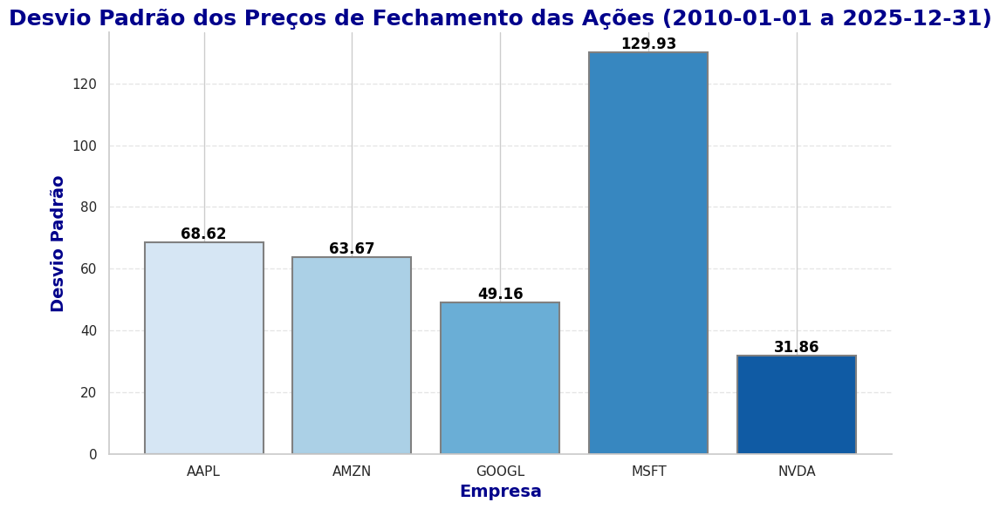

In [69]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Definir um estilo mais bonito usando seaborn
sns.set(style="whitegrid", palette="muted")

# Calcular o desvio padrão para cada uma das empresas
std_values = [
    df['Close_AAPL'].std(),
    df['Close_AMZN'].std(),
    df['Close_GOOGL'].std(),
    df['Close_MSFT'].std(),
    df['Close_NVDA'].std()
]
companies = ['AAPL', 'AMZN', 'GOOGL', 'MSFT', 'NVDA']

# Criar gráfico de barras
fig, ax = plt.subplots(figsize=(10, 6))

# Usar uma paleta de cores mais suave do Seaborn
bars = ax.bar(companies, std_values, color=sns.color_palette("Blues", n_colors=5))

# Adicionar valores em cima de cada barra
for bar in bars:
    yval = bar.get_height()
    ax.text(bar.get_x() + bar.get_width() / 2, yval + 0.01, f'{yval:.2f}', 
            ha='center', va='bottom', fontsize=12, fontweight='bold', color='black')

# Títulos e rótulos
ax.set_title('Desvio Padrão dos Preços de Fechamento das Ações (2010-01-01 a 2025-12-31)', fontsize=18, fontweight='bold', color='darkblue')
ax.set_xlabel('Empresa', fontsize=14, fontweight='bold', color='darkblue')
ax.set_ylabel('Desvio Padrão', fontsize=14, fontweight='bold', color='darkblue')

# Melhorar as linhas de grade
ax.grid(axis='y', linestyle='--', alpha=0.5)

# Remover bordas do topo e da direita
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Ajustar layout e exibir
plt.tight_layout()

# Adicionar sombra para dar um efeito de profundidade
for bar in bars:
    bar.set_edgecolor('grey')
    bar.set_linewidth(1.5)

plt.show()


### 2. Return

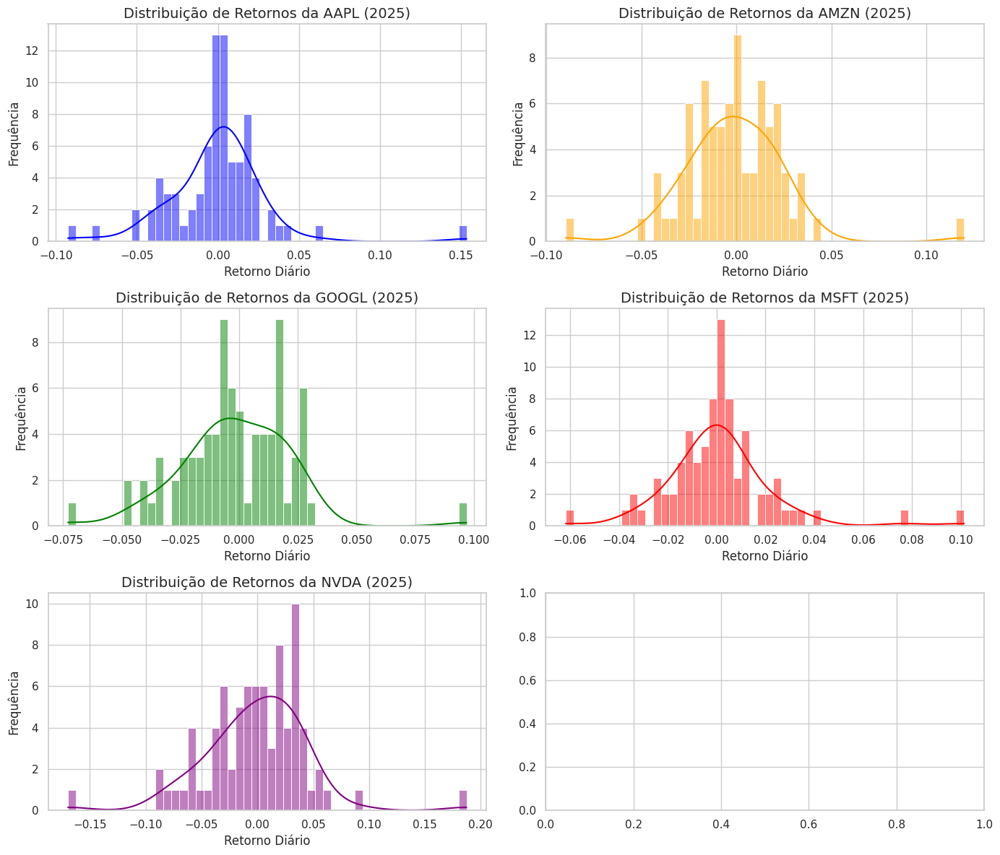

In [61]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Supondo que 'df' seja o seu DataFrame original com os preços das ações
# Garantir que a coluna 'Date' esteja em formato datetime
df['Date'] = pd.to_datetime(df['Date'])

# Calcular os retornos diários para cada ação
df['Return_AAPL'] = df['Close_AAPL'].pct_change()  # Retorno diário da AAPL
df['Return_AMZN'] = df['Close_AMZN'].pct_change()  # Retorno diário da AMZN
df['Return_GOOGL'] = df['Close_GOOGL'].pct_change()  # Retorno diário da GOOGL
df['Return_MSFT'] = df['Close_MSFT'].pct_change()  # Retorno diário da MSFT
df['Return_NVDA'] = df['Close_NVDA'].pct_change()  # Retorno diário da NVDA

# Filtrar os dados para o ano de 2015
df_2015 = df[(df['Date'] >= '2025-01-01') & (df['Date'] <= '2025-12-31')]

# Definir o tamanho da figura para 1 gráfico individual por vez
fig, axes = plt.subplots(3, 2, figsize=(14, 12))  # 3 linhas e 2 colunas
axes = axes.flatten()  # Facilita o acesso aos eixos para cada gráfico

# Plotando os retornos para cada ação em gráficos separados
sns.histplot(df_2015['Return_AAPL'].dropna(), kde=True, color='blue', ax=axes[0], bins=50)
axes[0].set_title('Distribuição de Retornos da AAPL (2025)', fontsize=14)
axes[0].set_xlabel('Retorno Diário', fontsize=12)
axes[0].set_ylabel('Frequência', fontsize=12)

sns.histplot(df_2015['Return_AMZN'].dropna(), kde=True, color='orange', ax=axes[1], bins=50)
axes[1].set_title('Distribuição de Retornos da AMZN (2025)', fontsize=14)
axes[1].set_xlabel('Retorno Diário', fontsize=12)
axes[1].set_ylabel('Frequência', fontsize=12)

sns.histplot(df_2015['Return_GOOGL'].dropna(), kde=True, color='green', ax=axes[2], bins=50)
axes[2].set_title('Distribuição de Retornos da GOOGL (2025)', fontsize=14)
axes[2].set_xlabel('Retorno Diário', fontsize=12)
axes[2].set_ylabel('Frequência', fontsize=12)

sns.histplot(df_2015['Return_MSFT'].dropna(), kde=True, color='red', ax=axes[3], bins=50)
axes[3].set_title('Distribuição de Retornos da MSFT (2025)', fontsize=14)
axes[3].set_xlabel('Retorno Diário', fontsize=12)
axes[3].set_ylabel('Frequência', fontsize=12)

sns.histplot(df_2015['Return_NVDA'].dropna(), kde=True, color='purple', ax=axes[4], bins=50)
axes[4].set_title('Distribuição de Retornos da NVDA (2025)', fontsize=14)
axes[4].set_xlabel('Retorno Diário', fontsize=12)
axes[4].set_ylabel('Frequência', fontsize=12)

# Ajustar o layout para evitar sobreposição
plt.tight_layout()
plt.show()


In [70]:
import plotly.graph_objects as go
import pandas as pd
from plotly.subplots import make_subplots

# Garantir que a coluna 'Date' está em datetime
df['Date'] = pd.to_datetime(df['Date'])
df.sort_values('Date', inplace=True)

# Filtrar período desejado
inicio = '2010-01-01'
fim = '2025-05-01'
df_filtro = df.loc[(df['Date'] >= inicio) & (df['Date'] <= fim)].copy()

# Calcular médias móveis para Microsoft, NVIDIA e Google
df_filtro['SMA20_MSFT'] = df_filtro['Close_MSFT'].rolling(window=20).mean()
df_filtro['SMA50_MSFT'] = df_filtro['Close_MSFT'].rolling(window=50).mean()

df_filtro['SMA20_NVDA'] = df_filtro['Close_NVDA'].rolling(window=20).mean()
df_filtro['SMA50_NVDA'] = df_filtro['Close_NVDA'].rolling(window=50).mean()

df_filtro['SMA20_GOOGL'] = df_filtro['Close_GOOGL'].rolling(window=20).mean()
df_filtro['SMA50_GOOGL'] = df_filtro['Close_GOOGL'].rolling(window=50).mean()

# Criar figura com subplots (agora com 3 empresas)
fig = make_subplots(rows=3, cols=1, shared_xaxes=True, vertical_spacing=0.07,
                    subplot_titles=("Microsoft (MSFT)", "NVIDIA (NVDA)", "Google (GOOGL)"))

# --- Microsoft (MSFT) ---
fig.add_trace(go.Candlestick(
    x=df_filtro['Date'],
    open=df_filtro['Open_MSFT'],
    high=df_filtro['High_MSFT'],
    low=df_filtro['Low_MSFT'],
    close=df_filtro['Close_MSFT'],
    name='MSFT',
    increasing_line_color='green',
    decreasing_line_color='red'
), row=1, col=1)

fig.add_trace(go.Scatter(
    x=df_filtro['Date'], y=df_filtro['SMA20_MSFT'],
    mode='lines', name='MSFT SMA20', line=dict(color='orange', width=1.5)
), row=1, col=1)

fig.add_trace(go.Scatter(
    x=df_filtro['Date'], y=df_filtro['SMA50_MSFT'],
    mode='lines', name='MSFT SMA50', line=dict(color='blue', width=1.5)
), row=1, col=1)

# --- NVIDIA (NVDA) ---
fig.add_trace(go.Candlestick(
    x=df_filtro['Date'],
    open=df_filtro['Open_NVDA'],
    high=df_filtro['High_NVDA'],
    low=df_filtro['Low_NVDA'],
    close=df_filtro['Close_NVDA'],
    name='NVDA',
    increasing_line_color='lightgreen',
    decreasing_line_color='crimson'
), row=2, col=1)

fig.add_trace(go.Scatter(
    x=df_filtro['Date'], y=df_filtro['SMA20_NVDA'],
    mode='lines', name='NVDA SMA20', line=dict(color='gold', width=1.5)
), row=2, col=1)

fig.add_trace(go.Scatter(
    x=df_filtro['Date'], y=df_filtro['SMA50_NVDA'],
    mode='lines', name='NVDA SMA50', line=dict(color='deepskyblue', width=1.5)
), row=2, col=1)

# --- Google (GOOGL) ---
fig.add_trace(go.Candlestick(
    x=df_filtro['Date'],
    open=df_filtro['Open_GOOGL'],
    high=df_filtro['High_GOOGL'],
    low=df_filtro['Low_GOOGL'],
    close=df_filtro['Close_GOOGL'],
    name='GOOGL',
    increasing_line_color='yellow',
    decreasing_line_color='purple'
), row=3, col=1)

fig.add_trace(go.Scatter(
    x=df_filtro['Date'], y=df_filtro['SMA20_GOOGL'],
    mode='lines', name='GOOGL SMA20', line=dict(color='red', width=1.5)
), row=3, col=1)

fig.add_trace(go.Scatter(
    x=df_filtro['Date'], y=df_filtro['SMA50_GOOGL'],
    mode='lines', name='GOOGL SMA50', line=dict(color='blue', width=1.5)
), row=3, col=1)

# --- Adicionar eventos importantes: Microsoft, NVIDIA e Google ---
eventos_msft = [
    {"data": "2019-07-22", "evento": "1B Open AI investment"},
    {"data": "2023-01-23", "evento": "10B Open AI investment"},
    {"data": "2023-11-29", "evento": "DeepSeek LLM"},
    {"data": "2025-01-17", "evento": "DeepSeek R1"}
]

eventos_nvda = [
    {"data": "2020-09-01", "evento": "AI chip production boost"},
    {"data": "2023-03-20", "evento": "H100 Launch (Hopper)"},
    {"data": "2023-11-29", "evento": "DeepSeek LLM"},
    {"data": "2025-01-17", "evento": "DeepSeek R1"}
]

eventos_googl = [
    {"data": "2020-08-01", "evento": "Launch of Google AI Research Lab"},
    {"data": "2021-10-04", "evento": "Google AI Breakthrough in NLP"},
    {"data": "2023-11-29", "evento": "DeepSeek LLM"},
    {"data": "2025-01-17", "evento": "DeepSeek R1"}
]

# Função para verificar e adicionar eventos
def adicionar_eventos(eventos, empresa, row, col):
    for evento in eventos:
        try:
            # Verificar se a data está presente no dataframe
            data_evento = pd.to_datetime(evento["data"])
            if data_evento in df_filtro['Date'].values:
                # Encontrar o preço de fechamento para a data do evento
                preco_evento = df_filtro.loc[df_filtro['Date'] == data_evento, f'Close_{empresa}'].values[0]
                # Adicionar anotação
                fig.add_annotation(
                    x=data_evento,
                    y=preco_evento,
                    text=evento["evento"],
                    showarrow=True,
                    arrowhead=2,
                    ax=0,
                    ay=-80,
                    font=dict(color="white"),
                    arrowcolor="yellow",
                    bgcolor="black",
                    opacity=0.8,
                    row=row, col=col
                )
            else:
                print(f"Data {evento['data']} não encontrada para {empresa}.")
        except Exception as e:
            print(f"Erro ao adicionar evento {evento['evento']}: {str(e)}")

# Adicionar eventos de Microsoft, NVIDIA e Google
adicionar_eventos(eventos_msft, 'MSFT', 1, 1)
adicionar_eventos(eventos_nvda, 'NVDA', 2, 1)
adicionar_eventos(eventos_googl, 'GOOGL', 3, 1)

fig.update_layout(
    title='📊 Microsoft, NVIDIA & Google Daily Price Volatility (Candlestick + SMA) com Eventos Importantes',
    xaxis_title='Date',
    yaxis_title='Price (USD)',
    xaxis_rangeslider=dict(visible=False),
    xaxis2_rangeslider=dict(visible=False),
    xaxis3_rangeslider=dict(visible=False),
    template='plotly_dark',
    height=1200,
    hovermode='x unified'
)


fig.show(renderer="notebook")


Data 2020-08-01 não encontrada para GOOGL.


## 5. Box Plot by Year or Month

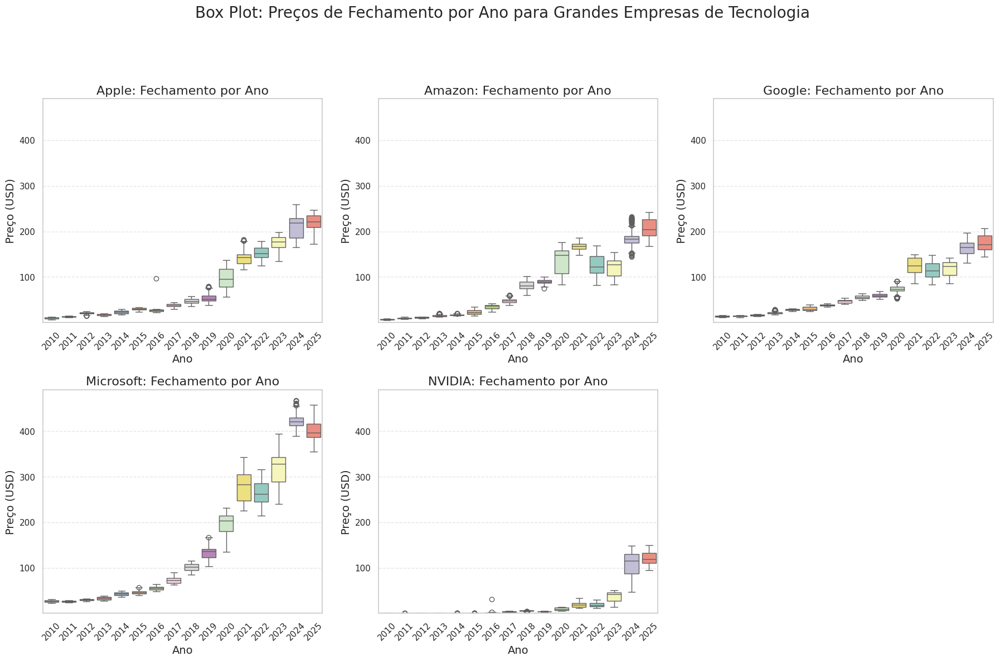

In [71]:
# 📊 Box Plot of Annual Closing Prices for Major Tech Companies (Apple, Amazon, Google, Microsoft, NVIDIA)
#
# This visualization presents annual box plots of closing stock prices for five leading tech companies from the dataset.
# Each subplot shows the distribution of closing prices by year, allowing for visual comparison of trends, medians, and volatility across time.
# Uniform y-axis limits are applied to standardize comparisons, and gridlines help emphasize shifts in yearly price ranges.
# This analysis provides insights into how each company's stock behaved annually and can help detect outliers or periods of unusual price movement.


# Certificar que 'Date' está em datetime e extrair ano
df['Date'] = pd.to_datetime(df['Date'])
df['Year'] = df['Date'].dt.year

companies = ['AAPL', 'AMZN', 'GOOGL', 'MSFT', 'NVDA']
titles = ['Apple', 'Amazon', 'Google', 'Microsoft', 'NVIDIA']

fig, axes = plt.subplots(2, 3, figsize=(22, 12))

# Ajusta espaçamento e título geral
fig.suptitle('Box Plot: Preços de Fechamento por Ano para Grandes Empresas de Tecnologia', fontsize=20, y=1.02)
plt.subplots_adjust(hspace=0.3, wspace=0.2)

# Descobre limite máximo e mínimo para uniformizar eixo y
ymin = df[[f'Close_{c}' for c in companies]].min().min()
ymax = df[[f'Close_{c}' for c in companies]].max().max()

for i, company in enumerate(companies):
    data = df[['Year', f'Close_{company}']].dropna()
    
    ax = axes[i//3, i%3]
    sns.boxplot(data=data, x='Year', y=f'Close_{company}', ax=ax, palette='Set3')
    
    ax.set_title(f'{titles[i]}: Fechamento por Ano', fontsize=16)
    ax.set_xlabel('Ano', fontsize=14)
    ax.set_ylabel('Preço (USD)', fontsize=14)
    
    # Rotaciona anos para melhor leitura
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
    
    # Ajusta limites y iguais para facilitar comparação
    ax.set_ylim(ymin * 0.95, ymax * 1.05)
    
    # Grid horizontal para facilitar leitura
    ax.grid(axis='y', linestyle='--', alpha=0.5)

# Remove subplot vazio (último) pois só 5 empresas
axes[1, 2].axis('off')

plt.show()


## 6. Heatmap of Correlation

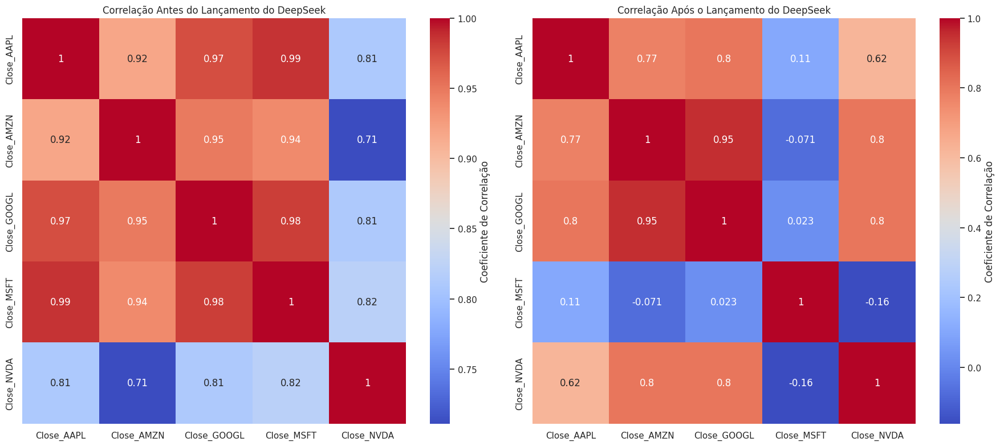

In [72]:
import matplotlib.pyplot as plt
import seaborn as sns

# Definir as colunas de fechamento das empresas
close_columns = ['Close_AAPL', 'Close_AMZN', 'Close_GOOGL', 'Close_MSFT', 'Close_NVDA']

# Definir a data do lançamento do DeepSeek
deepseek_launch_date = '2025-01-20'

# Calcular a correlação antes e depois do lançamento
correlation_before = df[df['Date'] < deepseek_launch_date][close_columns].corr()
correlation_after = df[df['Date'] >= deepseek_launch_date][close_columns].corr()

# Criando o gráfico com duas subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8))

# Heatmap para a correlação antes do lançamento
sns.heatmap(correlation_before, annot=True, cmap='coolwarm', ax=ax1, cbar_kws={'label': 'Coeficiente de Correlação'})
ax1.set_title('Correlação Antes do Lançamento do DeepSeek')

# Heatmap para a correlação após o lançamento
sns.heatmap(correlation_after, annot=True, cmap='coolwarm', ax=ax2, cbar_kws={'label': 'Coeficiente de Correlação'})
ax2.set_title('Correlação Após o Lançamento do DeepSeek')

# Ajustando o layout para garantir que tudo seja exibido corretamente
plt.tight_layout()
plt.show()


## 9. Lag Plots & ACF/PACF

In [ ]:
🧠 Forecasting Preparation: Lag Plot, ACF & PACF

Before using forecasting models like ARIMA or SARIMAX, we use three key tools: Lag Plot, ACF, and PACF. These help us understand how past values in a time series affect future ones.
🔁 Steps:

    📉 Lag Plot:
    Shows the relationship between current and past values of a time series.
    It helps us see if there are repeating patterns or if the data is random.

    📊 ACF (Autocorrelation Function):
    Measures how much current values are related to past values across different time lags.
    This helps us understand how far back the influence from the past goes.

    📈 PACF (Partial Autocorrelation Function):
    Also shows the relationship between values and their lags, but focuses on the direct effect of each lag, ignoring shorter ones.
    It's useful to decide how many lag terms to include in an ARIMA model.

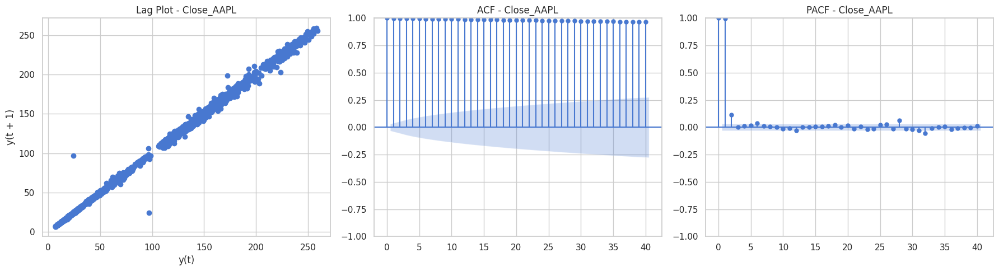

In [74]:
# --- Lag Plot, ACF & PACF for Time Series Analysis ---
# Visualize autocorrelation patterns to help guide ARIMA/SARIMAX modeling.

import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from pandas.plotting import lag_plot


# Definir 'Date' como índice para séries temporais
df_9 = df.set_index('Date')

# Selecionar a série temporal para análise
company = 'Close_AAPL'

# Criar figura com subplots para lag plot, ACF e PACF
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Lag plot: relação entre valor atual e valor defasado
lag_plot(df_9[company], ax=axes[0])
axes[0].set_title(f'Lag Plot - {company}')

# ACF plot: autocorrelação em vários lags
plot_acf(df_9[company].dropna(), lags=40, ax=axes[1])
axes[1].set_title(f'ACF - {company}')

# PACF plot: autocorrelação parcial para identificar ordens AR
plot_pacf(df_9[company].dropna(), lags=40, ax=axes[2], method='ywm')
axes[2].set_title(f'PACF - {company}')

plt.tight_layout()
plt.show()
